In [1]:
import scanpy as sc
import anndata as ad
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import swifter

sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.settings.figdir = "./figures/umap/"
sc.set_figure_params(dpi=80, dpi_save=300, frameon=True, vector_friendly=True, figsize=[8,5])

In [2]:
adata = ad.read_h5ad("anndata_after_qc.h5ad")
adata

AnnData object with n_obs × n_vars = 105262 × 499
    obs: 'x', 'y', 'cluster', 'n_transcripts', 'density', 'elongation', 'area', 'avg_confidence', 'cell_shape', 'n_genes', 'n_genes_by_counts', 'total_counts'
    var: 'n_cells', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts'
    uns: 'points'
    obsm: 'spatial', 'unrolled'

In [3]:
markers = [
    "Xist",
    "Epcam"
]

In [4]:
sc.experimental.pp.highly_variable_genes(
        adata, flavor="pearson_residuals", n_top_genes=2000
)

extracting highly variable genes
--> added
    'highly_variable', boolean vector (adata.var)
    'highly_variable_rank', float vector (adata.var)
    'highly_variable_nbatches', int vector (adata.var)
    'highly_variable_intersection', boolean vector (adata.var)
    'means', float vector (adata.var)
    'variances', float vector (adata.var)
    'residual_variances', float vector (adata.var)


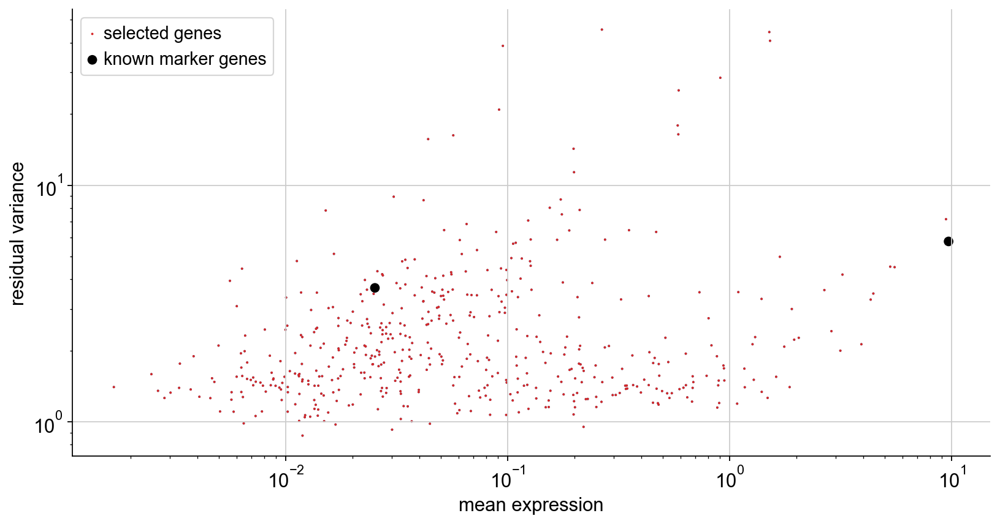

In [5]:
fig, ax = plt.subplots(1, 1, figsize=(12, 6))
hvgs = adata.var["highly_variable"]
ax.scatter(
    adata.var["mean_counts"], adata.var["residual_variances"], s=3, edgecolor="none"
)
ax.scatter(
    adata.var["mean_counts"][hvgs],
    adata.var["residual_variances"][hvgs],
    c="tab:red",
    label="selected genes",
    s=3,
    edgecolor="none",
)
ax.scatter(
    adata.var["mean_counts"][np.isin(adata.var_names, markers)],
    adata.var["residual_variances"][np.isin(adata.var_names, markers)],
    c="k",
    label="known marker genes",
    s=50,
    edgecolor="none",
)
ax.set_xscale("log")
ax.set_xlabel("mean expression")
ax.set_yscale("log")
ax.set_ylabel("residual variance")

ax.spines["right"].set_visible(False)
ax.spines["top"].set_visible(False)
ax.yaxis.set_ticks_position("left")
ax.xaxis.set_ticks_position("bottom")
plt.legend(loc='upper left')

In [6]:
#keep raw and depth-normalized counts for later
adata.layers["raw"] = adata.X.copy()
adata.layers["sqrt_norm"] = np.sqrt(
    sc.pp.normalize_total(adata, inplace=False)["X"]
)


normalizing counts per cell
    finished (0:00:00)


In [7]:
sc.experimental.pp.normalize_pearson_residuals(adata)

computing analytic Pearson residuals on adata.X
    finished (0:00:00)


In [8]:
sc.pp.pca(adata, n_comps=30)

computing PCA
    on highly variable genes
    with n_comps=30
    finished (0:00:02)


In [9]:
sc.pp.neighbors(adata, n_neighbors=30, n_pcs=30, metric='correlation')

computing neighbors
    using 'X_pca' with n_pcs = 30
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:29)


In [10]:
sc.tl.umap(adata, min_dist=0.3)

computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:01:01)


In [11]:
sc.tl.leiden(adata)

running Leiden clustering
    finished: found 32 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:57)


# Annotation

In [12]:
import csv
with open('Ucell_celltypes_v1.csv', "r") as f:
    reader = csv.reader(f)
    marker_genes_dict = {}

    for row in reader:
        key = row[0]
        # this removes the empty values
        marker_genes_dict[key] = [i for i in row[1:] if i]

In [13]:
all_marker_genes = np.concatenate([*marker_genes_dict.values()])
all_marker_genes = [i.strip(r"\+|\-") for i in all_marker_genes]
all_marker_genes = np.unique(all_marker_genes)
all_marker_genes = np.append(all_marker_genes, 'leiden')

/home/max/QnapSync/Documents/Postdoc/Lab/Projects/Merscope/Slide01_Doudenum/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


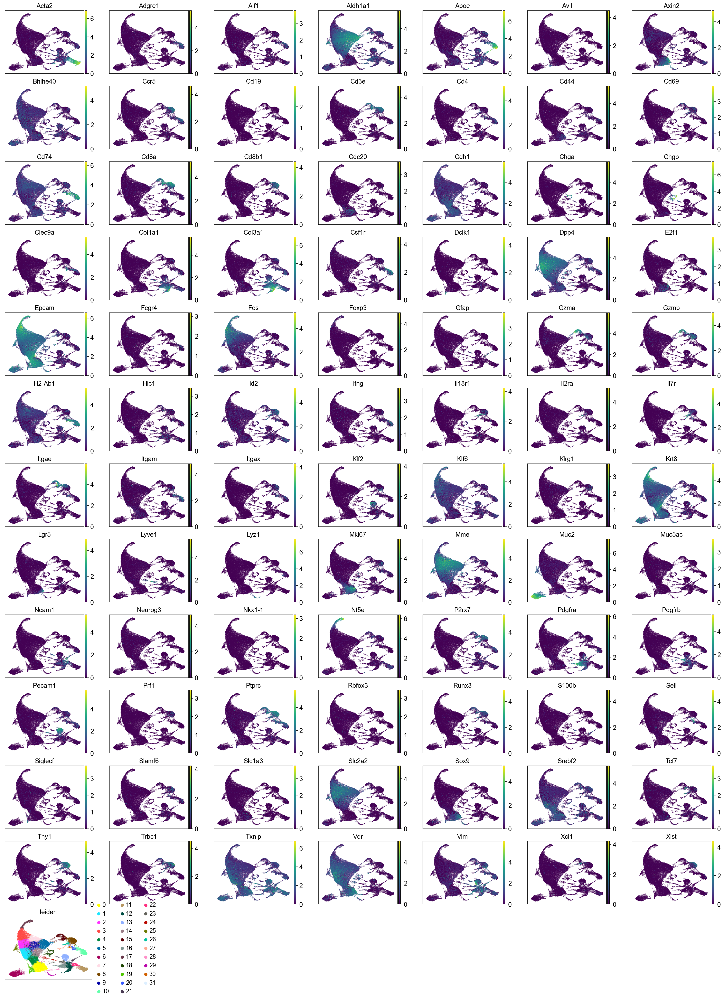

In [14]:
def ceiling_division(numerator, denominator):
    return -(-numerator // denominator)

ncol = 7
nrow = ceiling_division(len(all_marker_genes),ncol)

fig = plt.figure(figsize=(4*ncol, 3*nrow))
fig.tight_layout()
for i, m in enumerate(all_marker_genes):
    ax = plt.subplot(nrow, ncol, i+1)
    sc.pl.umap(adata, color=m, layer="sqrt_norm", ax=ax, show=False)
    ax.set(xlabel=None)
    ax.set(ylabel=None)
fig.savefig("./figures/umap/Marker_genes.png", bbox_inches='tight')

Let's create our own U Cell implementation

In [15]:
def create_rankings(ex_mtx: pd.DataFrame, seed=None) -> pd.DataFrame:
    """
    Create a rankings dataframe from a single cell expression profile dataframe.
    :param ex_mtx: The expression profile matrix. The rows should correspond to different cells, the columns to different
        genes (n_cells x n_genes).
    :return: A genome rankings dataframe (n_cells x n_genes).
    """

    return (
        ex_mtx.sample(frac=1.0, replace=False, axis=1, random_state=seed)
        .rank(axis=1, ascending=False, method="first", na_option="bottom")
        .astype('uint32')
    )

def u_stat(ranks, maxRank=100):
    ranks = ranks.copy()
    ranks[ranks > maxRank] = maxRank+1
    rank_sum = ranks.sum(axis =1) 
    len_sig = len(ranks.columns)
    if len_sig==0:
        return 0
    u_value = rank_sum - (len_sig * (len_sig + 1))/2
    auc = 1 - u_value/(len_sig * maxRank)
    return(auc)

In [16]:
def _calc_score(m, signature):
    sig_neg = [m.strip(r"\+|\-") for m in signature if m.endswith("-")]
    sig_pos = [m.strip(r"\+|\-") for m in signature if not m.endswith("-")]

    return(u_stat(ranks = m[sig_pos]) - u_stat(ranks = m[sig_neg]))

def calc_scores(adata, marker_genes_dict):
    m = pd.DataFrame(adata.layers['sqrt_norm'], columns=adata.var_names)
    m = create_rankings(pd.DataFrame(m), seed=42)

    scores = {}
    for k, v in marker_genes_dict.items():
        scores["Ucell_"+k] = _calc_score(m, v)

    scores = pd.DataFrame(scores)
    scores[scores < 0] = 0
    return(scores)

scores = calc_scores(adata, marker_genes_dict)

In [17]:
scores

,Ucell_Main.Epithelia,Ucell_Main.Stroma,Ucell_Main.Immune,Ucell_Main.Endothelia,Ucell_Main.Neuronal,Ucell_CD8_Tcell,Ucell_CD4_Tcell,Ucell_Treg,Ucell_NK_Tcell,Ucell_TRM_CD8_Tcell,...,Ucell_Ncam1+_fibroblasts,Ucell_Fibroblast_progenitor,Ucell_Pdgfra+_fibroblasts,Ucell_Acta2+_fibroblasts,Ucell_Pdgfrb+_fibroblasts,Ucell_Proliferating,Ucell_Lymphatic,Ucell_Astrocytes,Ucell_Neuron,Ucell_Microglia
0,0.945000,0.0,0.131667,0.00,0.0,0.020,0.0100,0.010,0.0,0.035625,...,0.000000,0.000000,0.0,0.0,0.000,0.01,0.0,0.0150,0.0,0.005
1,0.804167,0.0,0.000000,0.04,0.0,0.034,0.0000,0.125,0.0,0.147500,...,0.000000,0.000000,0.0,0.0,0.000,0.01,0.0,0.0150,0.0,0.275
2,0.788333,0.0,0.096667,0.03,0.0,0.030,0.0000,0.000,0.0,0.145000,...,0.000000,0.000000,0.0,0.0,0.000,0.01,0.0,0.0150,0.0,0.005
3,0.755000,0.0,0.186667,0.27,0.0,0.270,0.1125,0.050,0.0,0.181250,...,0.000000,0.000000,0.0,0.0,0.000,0.01,0.0,0.0150,0.0,0.005
4,0.305000,0.0,0.131667,0.66,0.0,0.122,0.0000,0.000,0.0,0.236250,...,0.203333,0.039286,0.0,0.0,0.005,0.01,0.0,0.0150,0.0,0.005
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
105257,0.000000,0.0,0.131667,0.66,0.0,0.132,0.0000,0.000,0.0,0.236250,...,0.203333,0.037857,0.0,0.0,0.005,0.01,0.0,0.0150,0.0,0.005
105258,0.000000,0.0,0.131667,0.66,0.0,0.112,0.0000,0.000,0.0,0.297500,...,0.203333,0.040714,0.0,0.0,0.005,0.01,0.0,0.0175,0.0,0.005
105259,0.321667,0.0,0.275000,0.62,0.0,0.146,0.0000,0.000,0.0,0.226250,...,0.000000,0.000000,0.0,0.0,0.000,0.01,0.0,0.0150,0.0,0.005
105260,0.941667,0.0,0.131667,0.66,0.0,0.122,0.0000,0.000,0.0,0.235625,...,0.000000,0.000000,0.0,0.0,0.000,0.01,0.0,0.0175,0.0,0.005


In [18]:
scores.index = adata.obs.index
adata.obs = pd.concat([adata.obs, scores], axis=1)

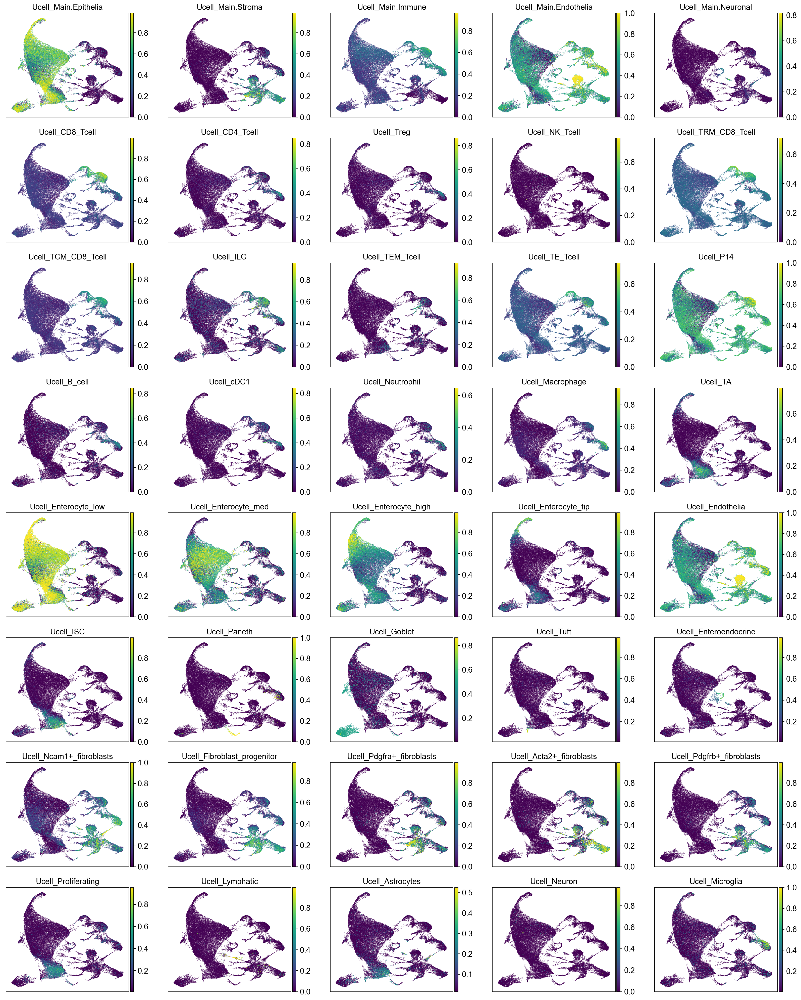

In [19]:
k = marker_genes_dict.keys()
ncol = 5
nrow = ceiling_division(len(k),ncol)

fig = plt.figure(figsize=(5*ncol, 4*nrow))
fig.tight_layout()
for i, m in enumerate(k):
    ax = plt.subplot(nrow, ncol, i+1)
    sc.pl.umap(adata, color="Ucell_"+m, ax=ax, show=False)
    ax.set(xlabel=None)
    ax.set(ylabel=None)
fig.savefig("./figures/umap/UCell_scores.png", bbox_inches='tight')

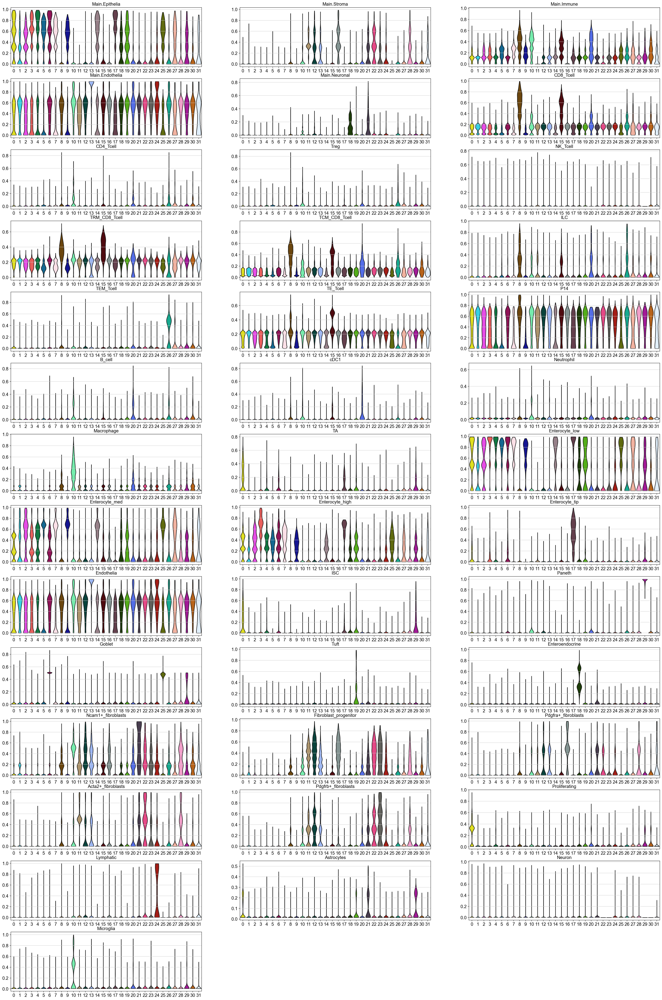

In [20]:
k = marker_genes_dict.keys()
ncol = 3
nrow = ceiling_division(len(k),ncol)

fig = plt.figure(figsize=(12*ncol, 4*nrow))
fig.tight_layout()
for i, m in enumerate(k):
    ax = plt.subplot(nrow, ncol, i+1)
    sc.pl.violin(adata, keys="Ucell_"+m, groupby='leiden',ax=ax, show=False,  stripplot=False)
    ax.set(xlabel=None)
    ax.set(ylabel=None)
    ax.set(title=m)
fig.savefig("./figures/umap/Violin_scores.png", bbox_inches='tight')

    using 'X_pca' with n_pcs = 30
Storing dendrogram info using `.uns['dendrogram_leiden']`


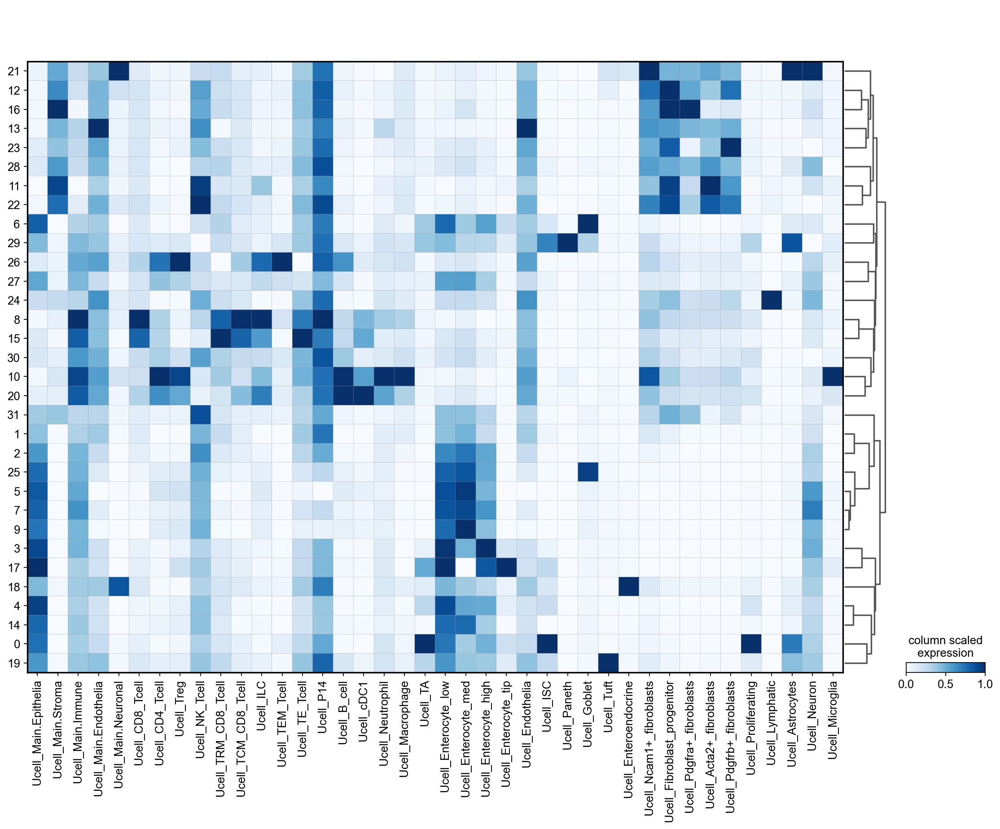

In [21]:
sc.pl.matrixplot(adata, ["Ucell_"+m for m in k], 'leiden', dendrogram=True, cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression')

/home/max/QnapSync/Documents/Postdoc/Lab/Projects/Merscope/Slide01_Doudenum/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


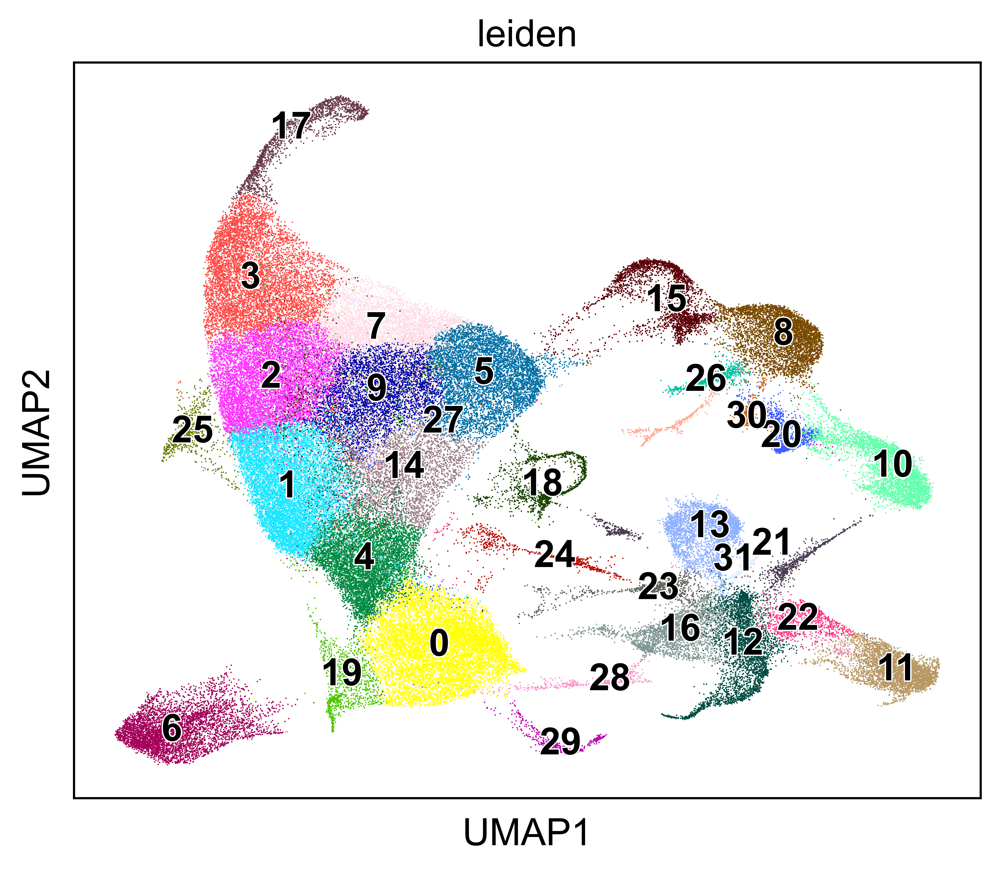

/home/max/QnapSync/Documents/Postdoc/Lab/Projects/Merscope/Slide01_Doudenum/.venv/lib/python3.10/site-packages/scanpy/plotting/_tools/scatterplots.py:392: UserWarning: No data for colormapping provided via 'c'. Parameters 'cmap' will be ignored
  cax = scatter(


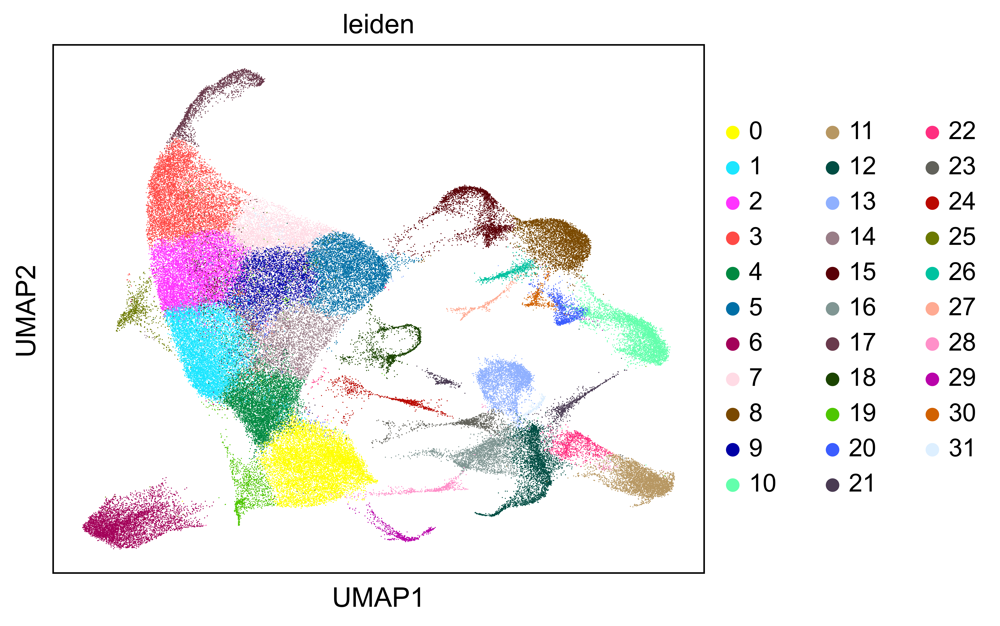

In [22]:
with plt.rc_context({"figure.figsize": (6, 5), "figure.dpi": (600)}):
    sc.pl.umap(adata, color='leiden', save="_leiden.png", legend_loc="on data", legend_fontoutline=1)

with plt.rc_context({"figure.figsize": (6, 5), "figure.dpi": (600)}):
    sc.pl.umap(adata, color='leiden', save="_leiden2.png")

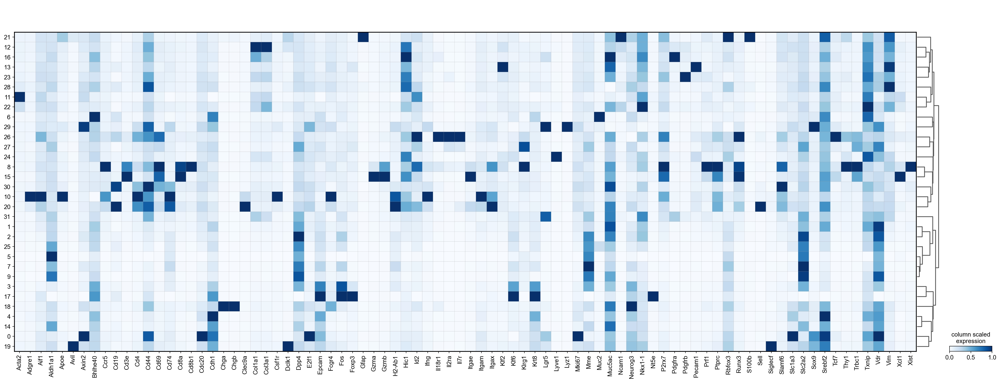

In [23]:
def unique_genes(gene_list):
    genes = [g for genes in gene_list.values() for g in genes]
    genes = [m.strip(r"\+|\-") for m in genes if not m.endswith("+-")]
    genes = np.unique(genes)
    return(genes)
sc.pl.matrixplot(adata, unique_genes(marker_genes_dict), 'leiden', dendrogram=True, cmap='Blues', standard_scale='var', colorbar_title='column scaled\nexpression')



In [28]:
cluster_to_celltype = {
    0: "Enterocyte, bottom",
    1: "Enterocyte",
    2: "Enterocyte",
    3: "Enterocyte",
    4: "Enterocyte",
    5: "Enterocyte",
    6: "Goblet",
    7: "Enterocyte",
    8: "CD8 P14",
    9: "Enterocyte",
    10: "other immune",

    11: "Fibroblast, Acta2",
    12: "Fibroblast",
    13: "Endothel",
    14: "Enterocyte",
    15: "CD8",
    16: "Fibroblast",
    17: "Enterocyte, tip",
    18: "Enteroendocrine",
    19: "Tuft",
    20: "B cells and DC",
    21: "Fibroblast",

    22: "Fibroblast",
    23: "Fibroblast",
    24: "Endothel",
    25: "Goblet",
    26: "CD4",
    27: "Enterocyte",
    28: "Fibroblast",
    29: "Paneth",
    30: "NK",
    31: "Intestinal stem cells",
}

adata.obs['celltype'] = adata.obs['leiden'].astype('int').map(cluster_to_celltype).astype("category")

In [29]:
adata.obs['celltype']

cell
1         Enterocyte, tip
2         Enterocyte, tip
3         Enterocyte, tip
4         Enterocyte, tip
5         Enterocyte, tip
               ...       
120618         Enterocyte
120619            CD8 P14
120626               Tuft
120630         Enterocyte
120631         Enterocyte
Name: celltype, Length: 105262, dtype: category
Categories (17, object): ['B cells and DC', 'CD4', 'CD8', 'CD8 P14', ..., 'NK', 'Paneth', 'Tuft', 'other immune']

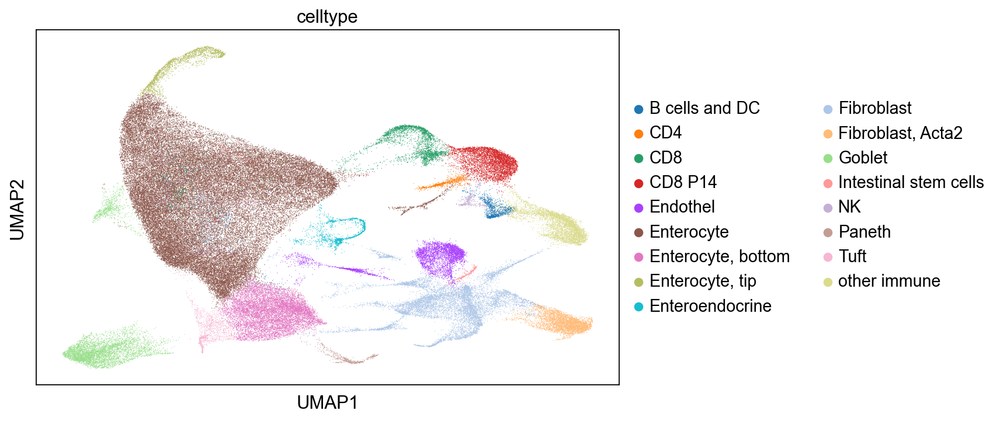

In [30]:
sc.pl.umap(adata, color='celltype')

In [31]:
adata.write("anndata_annotated.h5ad")